<a href="https://colab.research.google.com/github/sh99-git/Recruit-restaurants-visitors-forecasting/blob/main/Code/IBM_Capstone.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

---
># **Recruit Restaurant Visitor Forecasting** 
>### *IBM Advanced Data Science Capstone Project*
---
Among different ideas, one from kaggle is chosen as project. Given the quality of data and well defined prolem structure available on kaggle, The platform will help overcome major hurdle of defining a problem statement. Defining project aim and gathering necssary data is long process which needs much more time and resources than available in the timeframe of this project. 

Considering aim of this project to be exloring and applying the skills learned in this course. Project will focus on that aim only. And hence conmptition titled **Recruit Restaurant Visitor Forecasting** is chosen for source and target of data science project.




---
## Buiseness Understanding
---
Running a thriving local restaurant isn't always as charming as first impressions appear. There are often all sorts of unexpected troubles popping up that could hurt business.

One common predicament is that restaurants need to know how many customers to expect each day to effectively purchase ingredients and schedule staff members. This forecast isn't easy to make because many unpredictable factors affect restaurant attendance, like weather and local competition. It's even harder for newer restaurants with little historical data.

One of the prominent group of restaurants has unique access to key datasets that could make automated future customer prediction possible. Group has colected data from different entities, which are under it's umbrella, such as restaurant review service, restaurant point of sales service, and reservation log management software.

In this competition, you're challenged to use reservation and visitation data to predict the total number of visitors to a restaurant for future dates. This information will help restaurants be much more efficient and allow them to focus on creating an enjoyable dining experience for their customers.

---
## Initialization

Importing neceassary modules And Setting up the environment

### Importing Modules

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
import os
from google.colab import drive
drive.mount('/content/drive')
os.chdir(r'drive/MyDrive/Study/Data_Science/IBM_ADS/Capstone')
os.listdir()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


['Code', 'Data', 'Docs', 'Model', 'Output']

In [ ]:
import pandas as pd
import seaborn as sns
import numpy as np

import matplotlib.pyplot as plt
from prettytable import PrettyTable
from matplotlib_venn import venn3, venn3_circles
import plotly.express as px

from hyperopt import fmin, tpe, hp, Trials, STATUS_OK

from sklearn.ensemble import GradientBoostingRegressor
from sklearn import preprocessing as prepr_
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split, KFold

from keras.models import Model, Sequential
from keras.layers import Dense, LSTM, TimeDistributed, Input
from keras.optimizer_v2.adam import Adam

import pickle

%matplotlib inline

---

### Defining Custome Functions

In [ ]:
def lookup_df(df):
  '''
  Looks up data frame and prints data summary:
      - information 
      - description 
      - head 5 rows
  
  Parameters:
      df(Pandas.DataFrame) : Pandas dataframe.
  Returns:
      dataframe view 
  '''
  df.info()
  print(df.describe(include='all'))
  print(df.head())
  return None

In [ ]:
def get_AirID(HpgID):
  try:
    outp = dfStorJn.loc[HpgID].values[0]
  except KeyError:
    outp = HpgID

  return outp


dfStorJn = pd.read_csv('Data/store_id_relation.csv', index_col='HpgDbID')

In [ ]:
def show_values_on_bars(axs):
    def _show_on_single_plot(ax):        
        for p in ax.patches:
            _x = p.get_x() + p.get_width() / 2
            _y = p.get_y() + p.get_height() + 40
            value = '{:.2f}%'.format((p.get_height()/uniqGens.sum())*100)
            ax.text(_x, _y, value, ha="center") 

    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _show_on_single_plot(ax)
    else:
        _show_on_single_plot(axs)

---

---
## Extract-Transform-Load (ETL)
---
This is first step of project which involves extracting data from source; tranforming and formatting features; and loading it into accessible format for exploratory data analysis and rest of the process.


*   **Extraction**
      * Data source: In production system data will be loaded from reservation and hotel management system database. But for purpose of this project data is loaded from csv files provided by kaggle.
      * Data frames: To ease data exploration process we will load data in pandas datafeame. Apache spark is another option to store data. Since data is limited and we don not need Spark's scaling ability, Pandas is preferred.

*   **Transformation**
      * Data type: All data is observed and appropriate data types are allocated to features in dataframe.
      * Data aggregation: Categorical feature 'Genre' has 57 unique categories. To simplify calculation these categories are transformed to 13 categories.
      * Missing Values: Empty cells are checked. Since there are zero null values no transformation needed.

*   **Loading**
      * Data Combining: To prepare for data analysis data of different reservation systems is combined.








### Data Extraction

#### Visitor Data

In [ ]:
dfAirVst = pd.read_csv('Data/air_visit_data.csv')

In [ ]:
dfAirVst['VisitDT'] = dfAirVst['VisitDT'].astype('datetime64').dt.date
dfAirVst.set_index(['VisitDT', 'StoreID'], inplace=True)

In [ ]:
lookup_df(dfAirVst)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 252108 entries, (Timestamp('2016-01-13 00:00:00'), 'air_ba937bf13d40fb24') to (Timestamp('2017-04-22 00:00:00'), 'air_24e8414b9b07decb')
Data columns (total 1 columns):
 #   Column   Non-Null Count   Dtype
---  ------   --------------   -----
 0   VisitNO  252108 non-null  int64
dtypes: int64(1)
memory usage: 3.0+ MB
             VisitNO
count  252108.000000
mean       20.973761
std        16.757007
min         1.000000
25%         9.000000
50%        17.000000
75%        29.000000
max       877.000000
                                 VisitNO
VisitDT    StoreID                      
2016-01-13 air_ba937bf13d40fb24       25
2016-01-14 air_ba937bf13d40fb24       32
2016-01-15 air_ba937bf13d40fb24       29
2016-01-16 air_ba937bf13d40fb24       22
2016-01-18 air_ba937bf13d40fb24        6


#### Reservation Data

>##### Air Reservation

In [ ]:
dfAirRes = pd.read_csv('Data/air_reserve.csv')

In [ ]:
dfAirRes['VisitDT'] = dfAirRes['VisitDT'].astype('datetime64').dt.date
dfAirRes['ResrvDT'] = dfAirRes['ResrvDT'].astype('datetime64').dt.date
dfAirRes['ResDays'] = (dfAirRes['VisitDT'] - dfAirRes['ResrvDT'])/np.timedelta64(1, 'D')
dfAirRes.rename(columns = {'ResStor':'StoreID'}, inplace = True)
gbAirRes = dfAirRes.groupby(['VisitDT', 'StoreID'])
dfAirRes = pd.concat([gbAirRes['ResDays'].median(), gbAirRes['ResVstr'].sum()], axis=1)

In [ ]:
lookup_df(dfAirRes)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 29830 entries, (datetime.date(2016, 1, 1), 'air_877f79706adbfb06') to (datetime.date(2017, 5, 31), 'air_900d755ebd2f7bbd')
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   ResDays  29830 non-null  float64
 1   ResVstr  29830 non-null  int64  
dtypes: float64(1), int64(1)
memory usage: 588.6+ KB
            ResDays       ResVstr
count  29830.000000  29830.000000
mean       5.598274     13.879149
std        9.755162     23.729264
min        0.000000      1.000000
25%        1.000000      4.000000
50%        2.500000     10.000000
75%        7.000000     18.000000
max      349.500000   2241.000000
                                 ResDays  ResVstr
VisitDT    StoreID                               
2016-01-01 air_877f79706adbfb06      0.0        3
           air_db4b38ebe7a7ceff      0.0        9
           air_db80363d35f10926      0.0        5
2016-01-02 air_2b8b29ddfd35018e   

>##### Hpg Reservation

In [ ]:
dfHpgRes = pd.read_csv('Data/hpg_reserve.csv')

In [ ]:
dfHpgRes['VisitDT'] = dfHpgRes['VisitDT'].astype('datetime64').dt.date
dfHpgRes['ResrvDT'] = dfHpgRes['ResrvDT'].astype('datetime64').dt.date
dfHpgRes['ResDays'] = (dfHpgRes['VisitDT'] - dfHpgRes['ResrvDT'])/np.timedelta64(1, 'D')
dfHpgRes['ResStor'] = dfHpgRes['ResStor'].apply(get_AirID)
dfHpgRes.rename(columns = {'ResStor':'StoreID'}, inplace = True)
gbHpgRes = dfHpgRes.groupby(['VisitDT', 'StoreID'])
dfHpgRes = pd.concat([gbHpgRes['ResDays'].median(), gbHpgRes['ResVstr'].sum()], axis=1)

In [ ]:
lookup_df(dfHpgRes)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 773034 entries, (datetime.date(2016, 1, 1), 'air_08cb3c4ee6cd6a22') to (datetime.date(2016, 11, 30), 'hpg_fb9b33899f51aa41')
Data columns (total 2 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   ResDays  773034 non-null  float64
 1   ResVstr  773034 non-null  int64  
dtypes: float64(1), int64(1)
memory usage: 14.8+ MB
             ResDays        ResVstr
count  773034.000000  773034.000000
mean        6.469180       6.631166
std         7.378676       7.022075
min         0.000000       1.000000
25%         2.000000       2.000000
50%         4.000000       4.000000
75%         8.000000       8.000000
max       156.000000     180.000000
                                 ResDays  ResVstr
VisitDT    StoreID                               
2016-01-01 air_08cb3c4ee6cd6a22      0.0        2
           air_db80363d35f10926      0.0        4
           hpg_0168bd07d1336369      0.0        5
           

>##### Combining Data

In [ ]:
dfResJon = dfHpgRes[[('air' in idx[1]) for idx in dfHpgRes.index]]
dfResJon = dfResJon.join(dfAirRes, lsuffix='_h', rsuffix='_a', how='outer')
dfResJon.fillna(0, inplace=True)
dfResJon

ResDays_h  ResVstr_h  ResDays_a  ResVstr_a
VisitDT    StoreID                                                         
2016-01-01 air_08cb3c4ee6cd6a22        0.0        2.0        0.0        0.0
           air_877f79706adbfb06        0.0        0.0        0.0        3.0
           air_db4b38ebe7a7ceff        0.0        0.0        0.0        9.0
           air_db80363d35f10926        0.0        4.0        0.0        5.0
2016-01-02 air_08cb3c4ee6cd6a22        0.5        6.0        0.0        0.0
...                                    ...        ...        ...        ...
2017-05-29 air_db4b38ebe7a7ceff        0.0        0.0       42.0        6.0
2017-05-30 air_1033310359ceeac1        0.0        0.0       41.0        8.0
2017-05-31 air_3cad29d1a23209d2        0.0        0.0       39.0        3.0
           air_877f79706adbfb06        0.0        0.0       49.0        3.0
           air_900d755ebd2f7bbd        0.0        0.0       42.0       10.0

[39684 rows x 4 columns]

In [ ]:
dfResJon['ResDays'] = dfResJon[['ResDays_a', 'ResDays_h']].mean(axis=1) + 1
dfResJon['ResVstr'] = dfResJon[['ResVstr_a', 'ResVstr_h']].sum(axis=1)
dfResJon.drop(columns=['ResDays_a', 'ResDays_h', 'ResVstr_a', 'ResVstr_h'], inplace=True)
dfResJon

ResDays  ResVstr
VisitDT    StoreID                               
2016-01-01 air_08cb3c4ee6cd6a22     1.00      2.0
           air_877f79706adbfb06     1.00      3.0
           air_db4b38ebe7a7ceff     1.00      9.0
           air_db80363d35f10926     1.00      9.0
2016-01-02 air_08cb3c4ee6cd6a22     1.25      6.0
...                                  ...      ...
2017-05-29 air_db4b38ebe7a7ceff    22.00      6.0
2017-05-30 air_1033310359ceeac1    21.50      8.0
2017-05-31 air_3cad29d1a23209d2    20.50      3.0
           air_877f79706adbfb06    25.50      3.0
           air_900d755ebd2f7bbd    22.00     10.0

[39684 rows x 2 columns]

#### Store Data

>##### Air Stores

In [ ]:
dfAirStr = pd.read_csv('Data/air_store_info.csv', index_col='AirDbID')

In [ ]:
dfAirStr['AreaLoc'] = dfAirStr['AreaLoc'].apply(lambda lc: lc.lower())
dfAirStr.index.rename('StoreID', inplace=True)

In [ ]:
lookup_df(dfAirStr)

<class 'pandas.core.frame.DataFrame'>
Index: 829 entries, air_0f0cdeee6c9bf3d7 to air_c8fe396d6c46275d
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Genres_  829 non-null    object 
 1   AreaLoc  829 non-null    object 
 2   Latitud  829 non-null    float64
 3   Lngitud  829 non-null    float64
dtypes: float64(2), object(2)
memory usage: 32.4+ KB
        Genres_                         AreaLoc     Latitud     Lngitud
count       829                             829  829.000000  829.000000
unique       14                             103         NaN         NaN
top     Izakaya  fukuoka-ken fukuoka-shi daimyō         NaN         NaN
freq        197                              64         NaN         NaN
mean        NaN                             NaN   35.647042  137.415311
std         NaN                             NaN    2.084659    3.650971
min         NaN                             NaN   33.211967  130.195555
25%     

>##### Hpg Stores

In [ ]:
dfHpgStr = pd.read_csv('Data/hpg_store_info.csv', index_col='HpgDbID')

In [ ]:
dfHpgStr.index = dfHpgStr.apply(lambda row: get_AirID(row.name), axis=1)
dfHpgStr['AreaLoc'] = dfHpgStr['AreaLoc'].apply(lambda lc: lc.lower())
dfHpgStr.index.rename('StoreID', inplace=True)

In [ ]:
lookup_df(dfHpgStr)

<class 'pandas.core.frame.DataFrame'>
Index: 4690 entries, hpg_6622b62385aec8bf to hpg_11801306ce8bfb4f
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Genres_  4690 non-null   object 
 1   AreaLoc  4690 non-null   object 
 2   Latitud  4690 non-null   float64
 3   Lngitud  4690 non-null   float64
dtypes: float64(2), object(2)
memory usage: 183.2+ KB
               Genres_                    AreaLoc      Latitud      Lngitud
count             4690                       4690  4690.000000  4690.000000
unique              34                        119          NaN          NaN
top     Japanese style  tōkyō-to shinjuku-ku none          NaN          NaN
freq              1750                        257          NaN          NaN
mean               NaN                        NaN    35.810261   137.675816
std                NaN                        NaN     2.138755     3.197233
min                NaN                        NaN 

>##### Comparing Data

In [ ]:
dfStrCmpr = dfAirStr.join(dfHpgStr, rsuffix='_', how='inner')

In [ ]:
sum(abs(dfStrCmpr['Latitud']-dfStrCmpr['Latitud_']))

0.37474845000000556

In [ ]:
sum(abs(dfStrCmpr['Lngitud']-dfStrCmpr['Lngitud_']))

0.8080398000001878

#### Calender Data

In [ ]:
dfDatInf = pd.read_csv('Data/date_info.csv')

In [ ]:
dfDatInf['Date'] = dfDatInf['Date'].astype('datetime64')
dfDatInf.rename(columns={'Date': 'VisitDT'}, inplace=True)
dfDatInf.set_index('VisitDT', inplace=True)

In [ ]:
lookup_df(dfDatInf)

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 517 entries, 2016-01-01 to 2017-05-31
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Day_    517 non-null    object
 1   Flag    517 non-null    int64 
dtypes: int64(1), object(1)
memory usage: 12.1+ KB
          Day_        Flag
count      517  517.000000
unique       7         NaN
top     Friday         NaN
freq        74         NaN
mean       NaN    0.067698
std        NaN    0.251471
min        NaN    0.000000
25%        NaN    0.000000
50%        NaN    0.000000
75%        NaN    0.000000
max        NaN    1.000000
                Day_  Flag
VisitDT                   
2016-01-01    Friday     1
2016-01-02  Saturday     1
2016-01-03    Sunday     1
2016-01-04    Monday     0
2016-01-05   Tuesday     0


### Transform Data

In [ ]:
dates = dfAirVst.index.get_level_values(0)
hotels = dfAirVst.index.get_level_values(1).unique()
dtlist = pd.date_range(dates.min(), dates.max())

allIdx = pd.MultiIndex.from_product([dtlist, hotels], 
                                    names=['VisitDT', 'StoreID'])

dfAll = pd.DataFrame(index=allIdx)

In [ ]:
dfAll = dfAll.join(dfAirVst)
dfAll = dfAll.join(dfResJon)
dfAll = dfAll.join(dfAirStr)
dfAll = dfAll.join(dfDatInf)

In [ ]:
#dfAll['Genres_'] = dfAll['Genres_'].apply(lambda ls: deduplicate(ls))
dfAll[['City', 'Ward', 'Strt']] = dfAll.AreaLoc.str.split(pat=' ', n=2, 
                                                          expand=True)
dfAll['CO_Diff'] = dfAll['Latitud'] - dfAll['Lngitud']

In [ ]:
dfAll['WkDay'] = dfAll.index.get_level_values(0).weekday
dfAll['Wkend'] = dfAll['WkDay'].apply(lambda x: (x>4))
dfAll['Month'] = dfAll.index.get_level_values(0).month
dfAll['Year_'] = dfAll.index.get_level_values(0).year
dfAll['Date_'] = dfAll.index.get_level_values(0).day
dfAll['Week_'] = dfAll.index.get_level_values(0).week

In [ ]:
dfAll_WFt = dfAll.set_index('WkDay', append=True)
dfWKDFeat = dfAll_WFt.groupby(level=(1, 2))['VisitNO']\
                     .agg(['mean','count','std','min','max'])\
                     .set_axis(['vst_mean','vst_count','vst_std',
                                'vst_min', 'vst_max'], axis=1)
dfAll = dfAll_WFt.join(dfWKDFeat).reset_index(level='WkDay').swaplevel(0,1)

In [ ]:
dfAll_HDFt = dfAll[['Wkend', 'Flag']].groupby(level=0).mean()
dfAll_HDFt['NonWrk'] = dfAll_HDFt.apply(lambda row: int(np.any(row)), axis=1)
dfAll_HDFt['HDyEve'] = np.append(dfAll_HDFt['NonWrk'].values[1:], 0)
dfAll_HDFt.drop(columns=['Wkend', 'Flag'], inplace=True)
dfAll = dfAll.join(dfAll_HDFt)

### Load Data
Below is the summary of all loaded dataframes

Dataframe| Description
---------|------------------
dfDatInf | This file gives basic information about the calendar dates in the dataset.
dfAirRes | This file contains reservations made in the air system.
dfHpgRes | This file contains reservations made in the hpg system. 
dfStorJn | This file facilitate join of restaurants that have both the air and hpg system.
dfAirStr | This file contains information about select air restaurants.
dfHpgStr | This file contains information about select hpg restaurants.
dfAirVst | This file contains historical visit data for the air restaurants.
**dfAll** | **This is combination of all data**


Finally all data is loaded in *dfAll* DataFrame. And is ready for exploration

In [ ]:
lookup_df(dfAll)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 396262 entries, (Timestamp('2016-01-04 00:00:00'), 'air_00a91d42b08b08d9') to (Timestamp('2017-04-16 00:00:00'), 'air_fff68b929994bfbd')
Data columns (total 26 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   WkDay      396262 non-null  int64  
 1   VisitNO    252108 non-null  float64
 2   ResDays    38553 non-null   float64
 3   ResVstr    38553 non-null   float64
 4   Genres_    396262 non-null  object 
 5   AreaLoc    396262 non-null  object 
 6   Latitud    396262 non-null  float64
 7   Lngitud    396262 non-null  float64
 8   Day_       396262 non-null  object 
 9   Flag       396262 non-null  int64  
 10  City       396262 non-null  object 
 11  Ward       396262 non-null  object 
 12  Strt       396262 non-null  object 
 13  CO_Diff    396262 non-null  float64
 14  Wkend      396262 non-null  bool   
 15  Month      396262 non-null  int64  
 16  Year_      396262 non-null  int64  
 

In [ ]:
dfAll.to_csv(r'Data/combined_data.csv', na_rep='#')

---
## Exploratory Data Analysis (EDA)
---
Let's explore data to search patterns and trends in visitor numbers of a restaurants. In this phase we will try to discover hidden story behind the data.
Some of the analysis done includes:

* Identifying distribution of the restaurants over different reservation systems.

* Analysing distribution of genres in overall restaurants.

* Plotting geoographical distribution of restaurants.

* Understanding number of visitors across geographic area.

* Total visitors and visitors by genres over the time period of study.

* Trends in time series of visitors data over different time-units such as year, month, week, etc.

* Comparision of reservation versus actual visitors over a time period.

* Visitors over weekends and holidays.

### Distribution of restaurants in each system

In [ ]:
dfHpg = pd.read_csv('Data/hpg_store_info.csv')
dfAir = pd.read_csv('Data/air_store_info.csv')
dfCmb = pd.read_csv('Data/store_id_relation.csv')
inAirSys = set(dfAir['AirDbID'])
inHpgSys = set(dfHpg['HpgDbID'])
inCmpAir = set(dfCmb['AirDbID'])
inCmpHpg = set(dfCmb['HpgDbID'])

In [ ]:
print('Whether all AirIDs in joining set are present in Air System Database:')
print(inCmpAir.issubset(inAirSys))
print('Whether all HpgIDs in joining set are present in Hpg System Database:')
print(inCmpHpg.issubset(inHpgSys))

Whether all AirIDs in joining set are present in Air System Database:
True
Whether all HpgIDs in joining set are present in Hpg System Database:
False


In [ ]:
setAir = (inAirSys - inCmpAir) | inCmpHpg
setHpg = inHpgSys
setCmb = inCmpHpg
print(len(setAir), len(setHpg),len(setCmb))

829 4690 150


In [ ]:
dCount = {
    '001': len(setAir - (setCmb | setHpg)),
    '010': len(setCmb - (setAir | setHpg)),
    '100': len(setHpg - (setCmb | setAir)),
    '011': len((setAir & setCmb) - setHpg),
    '110': len((setHpg & setCmb) - setAir),
    '101': len((setAir & setHpg) - setCmb),
    '111': len((setAir & setCmb & setHpg))
}
print(dCount)

{'001': 679, '010': 0, '100': 4627, '011': 87, '110': 0, '101': 0, '111': 63}


In [ ]:
distTable = PrettyTable(["-", "AIR_SYS", "HPG_SYS"])
distTable.add_row(["Unique", dCount['001'], dCount['100']])
distTable.add_row(["Combine", (dCount['011']+dCount['111']), dCount['111']])
distTable.add_row(["Explicit", dCount['110'], dCount['011']])
print(distTable)

+----------+---------+---------+
|    -     | AIR_SYS | HPG_SYS |
+----------+---------+---------+
|  Unique  |   679   |   4627  |
| Combine  |   150   |    63   |
| Explicit |    0    |    87   |
+----------+---------+---------+


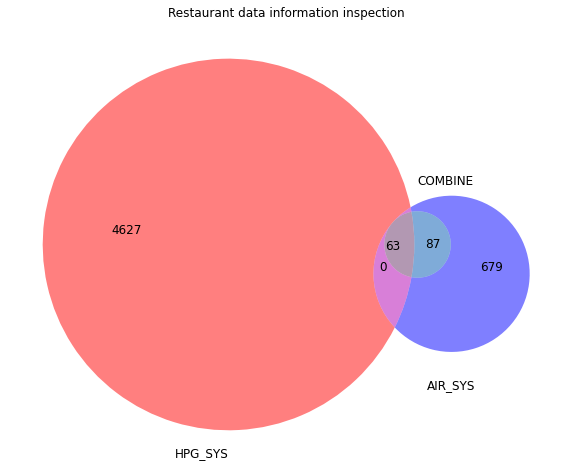

In [ ]:
labels = ('HPG_SYS', 'COMBINE', 'AIR_SYS')  
plt.figure(figsize=(10,30)) 
ax = plt.gca() 
vd3 = venn3([setHpg, setCmb, setAir], set_labels=labels, ax=ax, alpha=0.5)
for i, text in enumerate(vd3.set_labels):
  c = vd3.get_circle_center(i)
  r = vd3.get_circle_radius(i)
  x = c[0]
  y = c[1] - ((r+ 0.075)*((-1)**i))
  text.set_position((x, y))
  text.set_fontsize(12)
for text in vd3.subset_labels:
  if text != None:
    text.set_fontsize(12)
ax.set_title('Restaurant data information inspection')   
plt.show()

---
### Restaurant Genre Analysis
   As seen from analysis we have grouped earlier genres into 13 different genres. Let's check how restaurants are distributed over these genres.

--- 

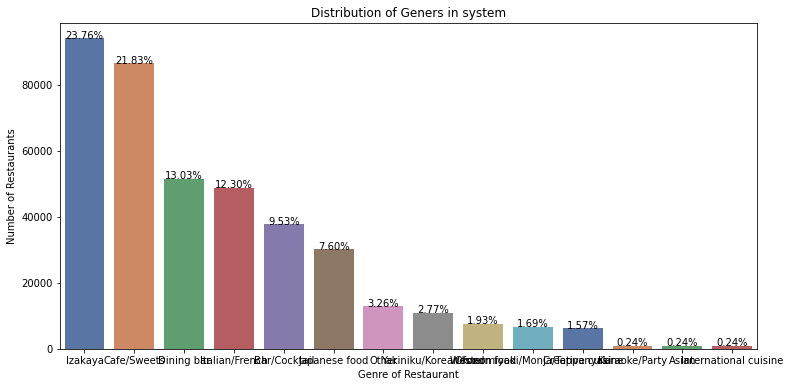

In [ ]:
uniqGens = dfAll['Genres_'].value_counts()

f, a = plt.subplots(1, 1, figsize=(12.5, 6))
p = sns.barplot(x=uniqGens.index, y=uniqGens.values, palette="deep", ax=a)
a.set_title("Distribution of Geners in system")
a.set_xlabel('Genre of Restaurant')
a.set_ylabel('Number of Restaurants')
show_values_on_bars(p)

### Location of Restaurants

In [ ]:
dfHtlLoc = dfAll.groupby('AreaLoc').mean()
dfHtlLoc['Counts'] = dfAll['AreaLoc'].value_counts()

fig = px.density_mapbox(dfHtlLoc, lat='Latitud', lon='Lngitud', z='Counts', 
                        radius=10, center=dict(lat=36.32, lon=136.53), zoom=0,
                        mapbox_style="open-street-map")
fig.show()

### Distribution of visitors over geographic location

In [ ]:
dfVstLoc = dfAll.groupby(level=1).sum().drop(columns=['Latitud', 'Lngitud'])
dfResLoc = dfAll[['Latitud', 'Lngitud', 'Genres_']]
dfVstLoc = dfVstLoc.join(dfResLoc, how='left')

fig = px.scatter_geo(dfVstLoc, lat='Latitud', lon='Lngitud', size='VisitNO',
                     color='Genres_', projection="natural earth")
fig.show()

### Distribution of visitors over time frame

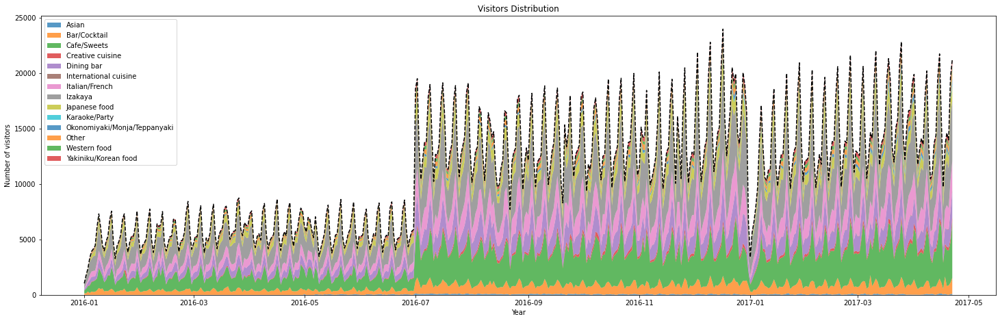

In [ ]:
dfPlotDt = (pd.get_dummies(dfAll['Genres_'])*
            dfAll['VisitNO'].values[:, None]).fillna(0)
dfPlotDt = dfPlotDt.groupby(level=0).sum()

fig, ax = plt.subplots(figsize=(25, 7.5))

ax.stackplot(dfPlotDt.index, dfPlotDt.transpose(), alpha=0.75,
             labels=dfPlotDt.columns)

ax.plot(dfPlotDt.index, dfPlotDt.sum(axis = 1), linewidth=1.5, 
        ls="--", color="black")

ax.legend(loc='upper left')
ax.set_title('Visitors Distribution')
ax.set_xlabel('Year')
ax.set_ylabel('Number of visitors')

plt.show()

### Trends in visitors

#### Trends over time-units

>##### Monthly visiting pattern by date

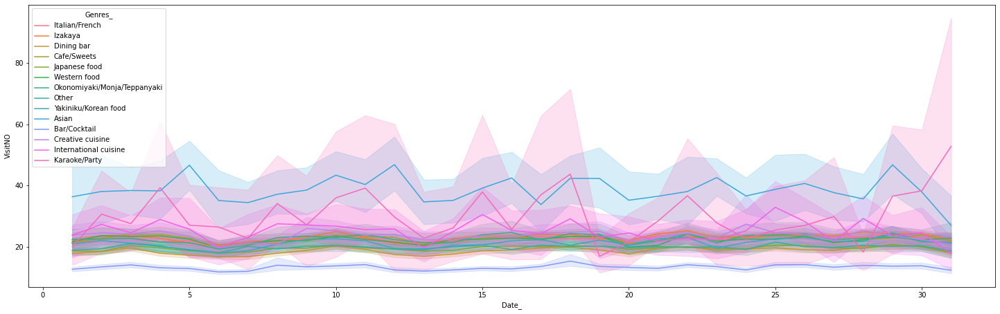

In [ ]:
f, a = plt.subplots(figsize=(25, 7.5))
sns.lineplot(x="Date_", y="VisitNO",
             hue="Genres_", data=dfAll, ax=a)

>##### Weekly visiting pattern by days

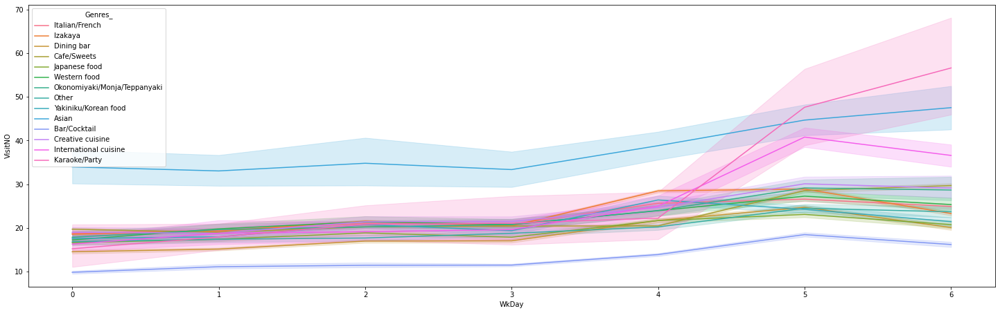

In [ ]:
f, a = plt.subplots(figsize=(25, 7.5))
sns.lineplot(x="WkDay", y="VisitNO",
             hue="Genres_", data=dfAll, ax=a)

>##### Yearly visiting pattern by weeks

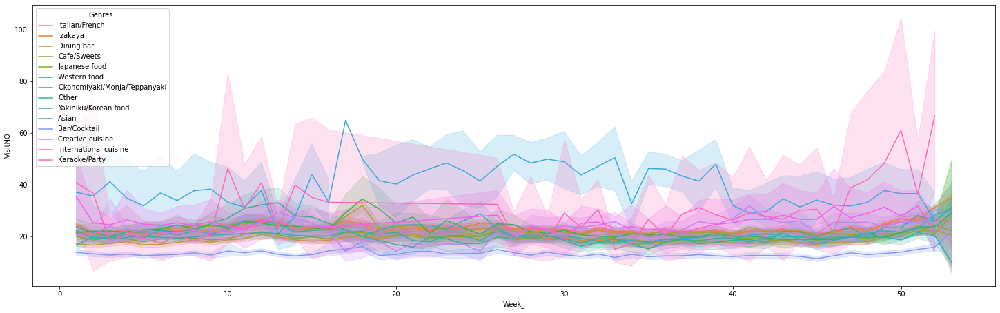

In [ ]:
f, a = plt.subplots(figsize=(25, 7.5))
sns.lineplot(x="Week_", y="VisitNO",
             hue="Genres_", data=dfAll, ax=a)

>##### Yearly visiting pattern by months

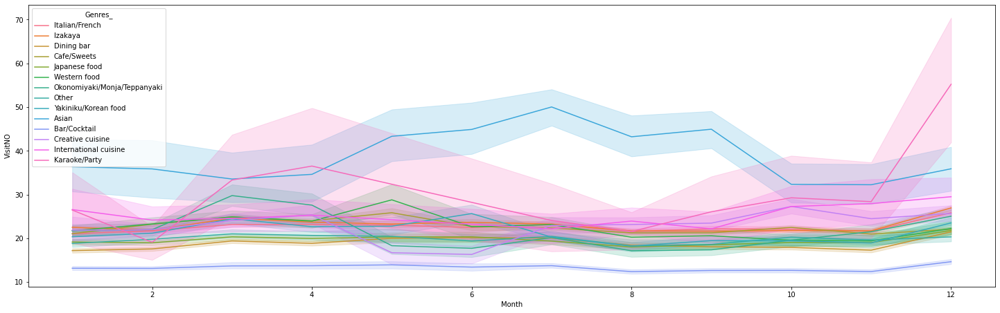

In [ ]:
f, a = plt.subplots(figsize=(25, 7.5))
sns.lineplot(x="Month", y="VisitNO",
             hue="Genres_", data=dfAll, ax=a)

#### Trends across time-units

>##### Day-wise visiting pattern across weeks

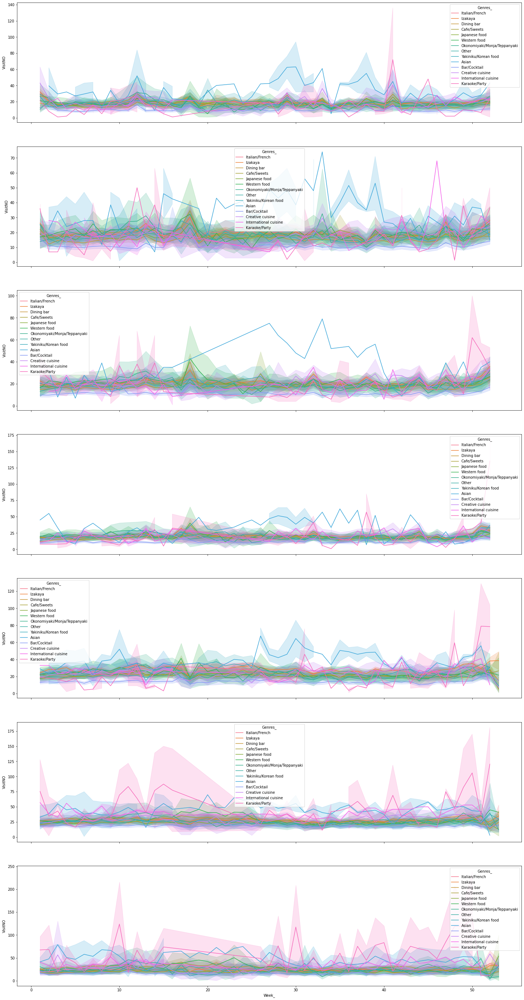

In [ ]:
days = dfAll['WkDay'].unique()

f, a = plt.subplots(len(days), 1, sharex=True, figsize=(25, 50))

for i, day in enumerate(days):
  dfDayPlt = dfAll[dfAll.WkDay==day]
  sns.lineplot(x="Week_", y="VisitNO", hue="Genres_", data=dfDayPlt, ax=a[i])

>##### Date-wise visiting pattern across months

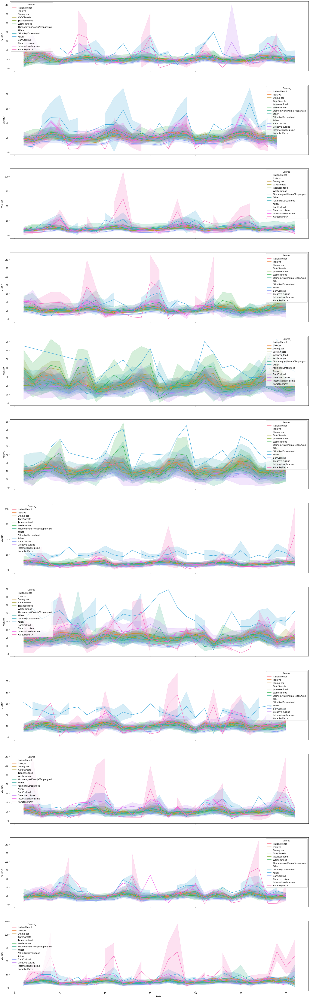

In [ ]:
mnths = dfAll['Month'].unique()

f, a = plt.subplots(len(mnths), 1, sharex=True, figsize=(25, 85))

for i, mnth in enumerate(mnths):
  dfMnthPlt = dfAll[dfAll.Month==mnth]
  sns.lineplot(x="Date_", y="VisitNO", hue="Genres_", data=dfMnthPlt, ax=a[i])

### Reservation v/s Actual visits

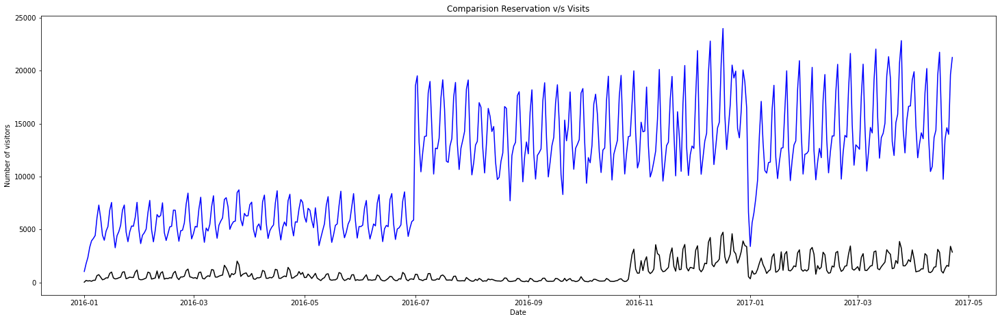

In [ ]:
dfResVstr = dfAll.groupby(level=0).sum()

fig, ax = plt.subplots(figsize=(25, 7.5))

ax.plot(dfResVstr.index, dfResVstr.VisitNO, linewidth=1.5, color="blue")

ax.plot(dfResVstr.index, dfResVstr.ResVstr, linewidth=1.5, color="black")

ax.set_title('Comparision Reservation v/s Visits')
ax.set_xlabel('Date')
ax.set_ylabel('Number of visitors')

plt.show()

### Visitors on Holidays

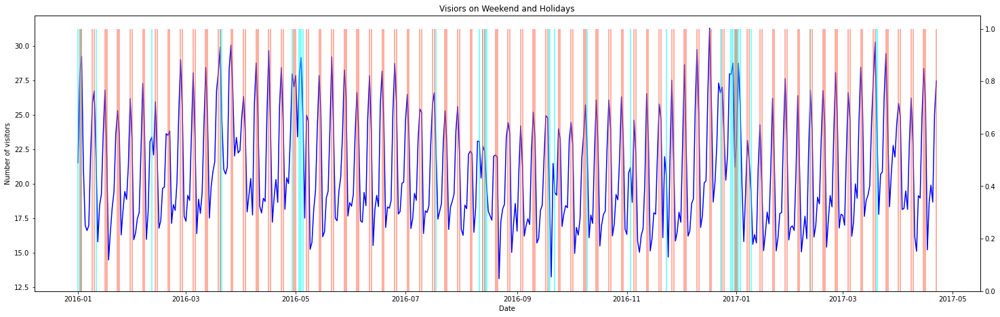

In [ ]:
dfHdyVstr = dfAll.groupby(level=0).mean()

fig, ax = plt.subplots(figsize=(25, 7.5))

ax.plot(dfHdyVstr.index, dfHdyVstr.VisitNO, linewidth=1.5, color="blue")

ax.set_title('Visiors on Weekend and Holidays')
ax.set_xlabel('Date')
ax.set_ylabel('Number of visitors')

a_ = ax.twinx()
a_.bar(dfHdyVstr.index, dfHdyVstr.Flag, color='cyan', alpha=0.5)
a_.bar(dfHdyVstr.index, dfHdyVstr.Wkend, color='tomato', alpha=0.5)

plt.show()

---
## Model Training & Evaluation
---

To solve this buiseness problem with machine learning, both classical and deep machine learning approach. From each category one algorithm is selected.

* **Classical ML** : Gradient Boosting Regresser\
Ensemble of gradient boost trees are proven to be more efective model in different kaggle compitition. Therefore GBM will be evaluated for it's performance.

* **Deep Learning** : LSTM(long short-term memory networks)\
LSTM is  capable of learning long-term dependencies, especially in sequence prediction problems. This problem can also be interpreted as time series analysis. Thus LSTM is another contender to solve our problem.

### Evaluation Metric
Since this is a regression problem multiple evaluation metrics are available. Among those RMSE(root mean squared error), R2(coefficient of determination), MAE(mean absolute error), MPE(mean percentage error) are more populer than the rest. And RMSLE(root mean squared lograthmic error) metric is new entry in that list. It is calculated as below:



\begin{align*}
    RMSLE = \sqrt{\frac{1}{n} \sum_{i=1}^n (\log(p_i + 1) - \log(a_i+1))^2 } \\
\end{align*}

Where:

$n$ is the total number of observations in the (public/private) data set,

$p_i$ is your prediction of target, and

$a_i$ is the actual target for $i$.

$log(x)$ is the natural logarithm of $x$ ($log_e(x)$.


For this problem we have chosen RMSLE as our metric. It offeres some benifits such as:
* Robustness to the effect of the outliers
* Measurement of relative error
* Biased penalty for overestimation

These benefits are advantegous for our buisness case. Thus a good metric for our model.

In [ ]:
def RMSLE(y_true, y_pred):
    yt = np.log1p(y_true.flatten())
    yp = np.log1p(y_pred.flatten())
    return mean_squared_error(yt, yp) ** 0.5

### GB Regressor - Training & Evaluation

#### Data Preperation

In [ ]:
dfLGBM = dfAll.loc[dfAll.VisitNO.dropna().index]
dfLGBM.fillna(-1, inplace=True)

In [ ]:
labler = prepr_.LabelEncoder()
 
for ft in ['Genres_', 'AreaLoc', 'City', 'Strt', 'Ward']:
  dfLGBM[ft] = labler.fit_transform(dfLGBM[ft])

In [ ]:
Y_Feat = ['VisitNO']
X_Feat = [col for col in dfLGBM.columns if (col not in ['VisitNO', 'Day_'])]

In [ ]:
dfLGBM.reset_index(inplace=True)
dfLGBM = dfLGBM.sample(frac=1, random_state=37)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(dfLGBM[X_Feat], dfLGBM[Y_Feat], train_size=0.8, random_state=43)
X_valid, X_test, y_valid, y_test = train_test_split(X_test, y_test, train_size=0.5, random_state=86)

#### Model Building

In [ ]:
n_folds = 5
kf = KFold(n_folds, random_state=45, shuffle=True)

In [ ]:
params = params = {'n_estimators': 100,
        'max_depth': 5,
        'min_samples_split': 200, 
        'min_samples_leaf': 50,
        'learning_rate': 0.005,
        'max_features':  9,}

In [ ]:
base_gbm = GradientBoostingRegressor(**params)

In [ ]:
def kFold_GBMpredictor(kf, model, X, y, Xtst):
  y_test_pred = 0
  for i, (train_index, test_index) in enumerate(kf.split(X)):
      # Create data for this fold
      y_tr, y_vl = y.iloc[train_index].copy(), y.iloc[test_index]
      X_tr, X_vl = X.iloc[train_index, :].copy(), X.iloc[test_index, :].copy()
      print("\nFold ", i)

      fit_model = model.fit(X_tr, y_tr)
      pred = model.predict(X_vl)
      print('RMSE GBM Regressor, fold ', i, ': ', RMSLE(y_vl.values, pred))
      print('Prediction length on validation set, GBM Regressor, fold ', i, ': ', len(pred))
      # Accumulate test set predictions

      pred = model.predict(Xtst)
      print('Prediction length on test set, GBM Regressor, fold ', i, ': ', len(pred))
      y_test_pred += pred

    
  return model, y_test_pred/(i+1)


In [ ]:
base_gbm, yp_vald = kFold_GBMpredictor(kf, base_gbm, X_train, y_train, X_valid)
print('\n'*5)
print('-'*100)
print(f'Performance of base model: {RMSLE(y_valid.values, yp_vald)}')


Fold  0
RMSE GBM Regressor, fold  0 :  0.7216882983749937
Prediction length on validation set, GBM Regressor, fold  0 :  40338
Prediction length on test set, GBM Regressor, fold  0 :  25211

Fold  1
RMSE GBM Regressor, fold  1 :  0.7254022395850411
Prediction length on validation set, GBM Regressor, fold  1 :  40337
Prediction length on test set, GBM Regressor, fold  1 :  25211

Fold  2
RMSE GBM Regressor, fold  2 :  0.7176941949617305
Prediction length on validation set, GBM Regressor, fold  2 :  40337
Prediction length on test set, GBM Regressor, fold  2 :  25211

Fold  3
RMSE GBM Regressor, fold  3 :  0.7266163567558622
Prediction length on validation set, GBM Regressor, fold  3 :  40337
Prediction length on test set, GBM Regressor, fold  3 :  25211

Fold  4
RMSE GBM Regressor, fold  4 :  0.7255865232591411
Prediction length on validation set, GBM Regressor, fold  4 :  40337
Prediction length on test set, GBM Regressor, fold  4 :  25211






---------------------------------------

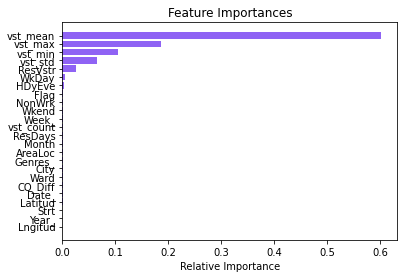

In [ ]:
features = X_train.columns.values
importances = base_gbm.feature_importances_
indices = np.argsort(importances)

plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='#8f63f4', align='center')
plt.yticks(range(len(indices)), features[indices])
plt.xlabel('Relative Importance')
plt.show()

#### Hyper-parameter Optimization

In [ ]:
lgbSpace = {'n_estimators': hp.choice('n_estimators', [3, 10, 30, 100, 300]), 
            'max_depth': hp.choice('max_depth',[3, 5, 9 ,15]),
            'min_samples_split': hp.choice('min_samples_split', [3, 5, 9, 17, 33]), 
            'min_samples_leaf': hp.choice('min_samples_leaf', [15, 30, 60, 120, 240]),
            'learning_rate': hp.loguniform('learning_rate',-6.9,-2.3),
            'max_features':  hp.choice('max_features', ['auto', 'sqrt', 'log2'])}

In [ ]:
def lgb_optimizer(params):
    '''A function to optimize  lgb classifier
    :params:=params , dictionary containing the Hyper-parameters for the classifier
    returns true loss and validation loss
    '''
    val_score=[]
    true_scores=[]
    rd=1
    for train_index, test_index in kf.split(X_valid, y_valid):
        X_tr, X_val = X_train.iloc[train_index], X_train.iloc[test_index]
        y_tr, y_val = y_train.iloc[train_index], y_train.iloc[test_index]
        
        pred = GradientBoostingRegressor(**params)
        pred.fit(X_tr, y_tr)
        
        y_pred = pred.predict(X_val)
        y_tr_pred = pred.predict(X_tr)
        score = RMSLE(y_val.values, y_pred)
        true_score = RMSLE(y_tr.values, y_tr_pred)
        
        val_score.append(score)
        true_scores.append(true_score)
        rd+=1
    mean, std = np.mean(val_score), np.std(val_score)
    true_mean = np.mean(true_scores)
    print("mean: {}, Std: {}".format(mean, std))
    return {'loss':-mean,'status': STATUS_OK,'true_loss':-true_mean}

In [ ]:
trials = Trials()
best_e = fmin(lgb_optimizer, lgbSpace, algo = tpe.suggest,
             max_evals = 10, trials=trials)

mean: 0.5559840448059279, Std: 0.008826716484705026
mean: 0.5484520052304509, Std: 0.008807762314515914
mean: 0.7679791029090235, Std: 0.0048979493054756304
mean: 0.6398449965657909, Std: 0.007095392873423776
mean: 0.8620030924872163, Std: 0.005178745418798131
mean: 0.6320792012627606, Std: 0.006800460290600534
mean: 0.8607112482765114, Std: 0.0054649995565991885
mean: 0.8620772496413627, Std: 0.005489661671218506
mean: 0.8403128467183375, Std: 0.005436972257303292
mean: 0.5358500717968325, Std: 0.009537953311722766
100%|██████████| 10/10 [01:56<00:00, 11.64s/it, best loss: -0.8620772496413627]


In [ ]:
print('Estimated best parameters:')
print(best_e)

#Updating params dict
o_params = {k: best_e[k] if best_e[k]>1 else params[k] for k in params.keys()}
print('Combined best parameters:')
print(o_params)

Estimated best parameters:
{'learning_rate': 0.0023807468391328717, 'max_depth': 0, 'max_features': 1, 'min_samples_leaf': 2, 'min_samples_split': 0, 'n_estimators': 0}
Combined best parameters:
{'n_estimators': 100, 'max_depth': 5, 'min_samples_split': 200, 'min_samples_leaf': 2, 'learning_rate': 0.005, 'max_features': 9}


#### Final Performance

In [ ]:
fine_gbm = GradientBoostingRegressor(**o_params)

In [ ]:
fine_gbm, yp_tst = kFold_GBMpredictor(kf, fine_gbm, X_train, y_train, X_test)

print('\n'*5)
print('-'*100)
print(f'Performance of fine-tuned model: {RMSLE(y_test.values, yp_tst)}')


Fold  0
RMSE GBM Regressor, fold  0 :  0.7217378279828329
Prediction length on validation set, GBM Regressor, fold  0 :  40338
Prediction length on test set, GBM Regressor, fold  0 :  25211

Fold  1
RMSE GBM Regressor, fold  1 :  0.7247495997750718
Prediction length on validation set, GBM Regressor, fold  1 :  40337
Prediction length on test set, GBM Regressor, fold  1 :  25211

Fold  2
RMSE GBM Regressor, fold  2 :  0.7163069414032709
Prediction length on validation set, GBM Regressor, fold  2 :  40337
Prediction length on test set, GBM Regressor, fold  2 :  25211

Fold  3
RMSE GBM Regressor, fold  3 :  0.7273174848990883
Prediction length on validation set, GBM Regressor, fold  3 :  40337
Prediction length on test set, GBM Regressor, fold  3 :  25211

Fold  4
RMSE GBM Regressor, fold  4 :  0.7257736906893604
Prediction length on validation set, GBM Regressor, fold  4 :  40337
Prediction length on test set, GBM Regressor, fold  4 :  25211






---------------------------------------

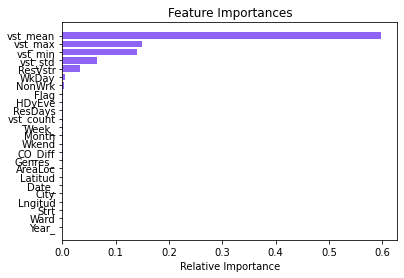

In [ ]:
features = X_train.columns.values
importances = fine_gbm.feature_importances_
indices = np.argsort(importances)

plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='#8f63f4', align='center')
plt.yticks(range(len(indices)), features[indices])
plt.xlabel('Relative Importance')
plt.show()

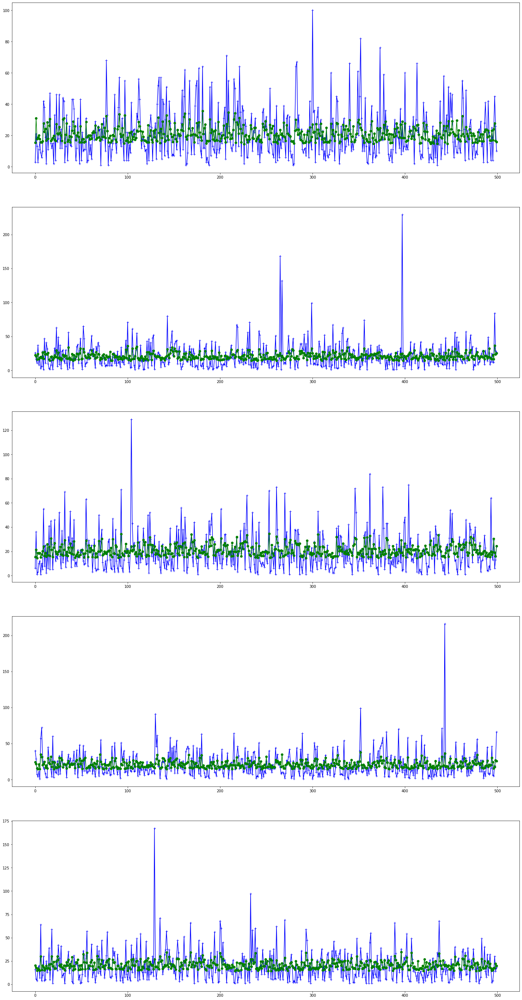

In [ ]:
fig, ax = plt.subplots(5, 1, figsize=(25, 50))
for i in range(5):
  k = np.random.randint(499)
  z = i*1000 + k
  ax[i].plot(y_test.values[z:z+500], '-+b')
  ax[i].plot(yp_tst[z:z+500], '-og')
plt.show()

### LSTM - Training & Evaluation

#### Data Preperation

In [ ]:
dfLSTM = dfAll.copy()
dfLSTM['HistDt'] = dfLSTM['VisitNO'].apply(lambda val: int(np.isnan(val)))
dfLSTM['VisitNO'].fillna(0, inplace = True)
dfLSTM = dfLSTM.swaplevel(0,1).fillna(-1)

In [ ]:
labler = prepr_.LabelEncoder()
 
for ft in ['Genres_', 'AreaLoc', 'City', 'Strt', 'Ward']:
  dfLSTM[ft] = labler.fit_transform(dfLSTM[ft])

In [ ]:
Y_Feat = ['VisitNO']
X_Feat = [col for col in dfLSTM.columns if (col not in ['VisitNO', 'Day_'])]

In [ ]:
idLen = len(dfLSTM.index.get_level_values(0).unique())
dtLen = len(dfLSTM.index.get_level_values(1).unique())
ftLen = len(X_Feat)  

trLen = dtLen - 94
tsLen = 47
ftAll = ftLen + 7

In [ ]:
x_lstm = dfLSTM[X_Feat].values.reshape(idLen, dtLen, ftLen)
y_lstm = dfLSTM[Y_Feat].values.reshape(idLen, dtLen, 1)

t_minus = -np.ones_like(y_lstm)
for i in range(1,8):
    temp = y_lstm.copy()
    temp[:, i:, :] = y_lstm[:, :-i, :].copy()
    t_minus = np.concatenate((t_minus[...], temp[...]), axis = 2)


x_lstm = np.concatenate([x_lstm, t_minus[:,:,1:]], axis=2)

In [ ]:
X_trn = x_lstm[:, :trLen, :].reshape(-1, ftAll)
y_trn = y_lstm[:, :trLen, :]
X_val = x_lstm[:, trLen:-tsLen, :].reshape(-1, ftAll)
y_val = y_lstm[:, trLen:-tsLen, :]
X_tst = x_lstm[:, -tsLen:, :].reshape(-1, ftAll)
y_tst = y_lstm[:, -tsLen:, :]

In [ ]:
scaler = prepr_.MinMaxScaler(feature_range=(-1, 1))

scaler.fit(X_trn)

X_trn = scaler.transform(X_trn).reshape(idLen, -1, ftAll)
X_val = scaler.transform(X_val).reshape(idLen, -1, ftAll)
X_tst = scaler.transform(X_tst).reshape(idLen, -1, ftAll)

#### Model Building

In [ ]:
def generate_timeseries(X, y, n):
    while True:
        dec_limit = X.shape[1] - n - 1
        
        i_enc = np.random.randint(0, dec_limit)
        e_enc = i_enc + n
        
        X_to_enc = X[:, i_enc:e_enc, :]
        X_to_dec = X[:, (i_enc+1):(e_enc+1), :]
        y_to_dec = y[:, (i_enc+1):(e_enc+1), :]
        
        yield([X_to_enc, X_to_dec], y_to_dec)

In [ ]:
def define_models(n_tokens, n_output=1, n_units=64, n_batch=1, t_steps=None):
  # define training encoder
  enc_inputs = Input(shape=(t_steps, n_tokens))

  enc_lstm_1 = LSTM(n_units,
                    batch_input_shape = (n_batch, t_steps, n_tokens),
                    recurrent_initializer='glorot_uniform', 
                    return_state=True)

  _, enc_state_h, enc_state_c = enc_lstm_1(enc_inputs)
  enc_states = [enc_state_h, enc_state_c]

  # define training decoder
  dec_inputs = Input(shape=(t_steps, n_tokens))
  
  dec_lstm_2 = LSTM(n_units, 
                    return_sequences=True,
                    batch_input_shape = (n_batch, t_steps, n_tokens),
                    dropout=0.2,
                    recurrent_dropout=0.2,
                    return_state=False)
  
  dec_output = dec_lstm_2(dec_inputs, initial_state=enc_states)
  
  dec_lstm_3 = LSTM(64, 
                    return_sequences=True,                    
                    dropout=0.2,
                    recurrent_dropout=0.2, 
                    return_state=True)
  
  dec_output, _, _ = dec_lstm_3(dec_output)

  dec_Tdense = TimeDistributed(Dense(n_output, activation='relu'))
  dec_output = dec_Tdense(dec_output)
  
  train_mdl = Model([enc_inputs, dec_inputs], dec_output)

  # define inference encoder
  enc_model = Model(enc_inputs, enc_states)

  # define inference decoder
  dec_st_ip_h = Input(shape=(n_units,))
  dec_st_ip_c = Input(shape=(n_units,))
  dec_st_inpt = [dec_st_ip_h, dec_st_ip_c]
  
  dec_output = dec_lstm_2(dec_inputs, initial_state=dec_st_inpt)
  dec_output, dec_state_h, dec_state_c = dec_lstm_3(dec_output)
  decoder_states = [dec_state_h, dec_state_c]
  dec_output = dec_Tdense(dec_output)
  dec_model = Model([dec_inputs] + dec_st_inpt, [dec_output])
  # return all models
  return train_mdl, enc_model, dec_model

In [ ]:
def create_and_train(model_params, series_params, lr=0.01, n_stp=5, n_epc=2):
  
  t_model, e_model, d_model = define_models(**model_params)

  t_model.compile(optimizer=Adam(learning_rate=lr), 
                  loss='mean_squared_logarithmic_error')
  
  t_model.fit_generator(generate_timeseries(**series_params), 
                        steps_per_epoch=n_stp, 
                        verbose=1, 
                        epochs=n_epc)
  return t_model, e_model, d_model

In [ ]:
def predict_sequence(inf_enc, inf_dec, ip_seq_x, ip_seq_y, target_seq, n_x):
  
  state = inf_enc.predict(ip_seq_x)
  target_seq = target_seq[:,:, :n_x]
  t_minus_seq = np.concatenate((ip_seq_y[:,-1:,:], ip_seq_x[:,-1:, n_x:-1]), axis = 2)
  current_seq = ip_seq_x.copy()
  output = np.ones([target_seq.shape[0], 1, 1])
  
  for i in range(target_seq.shape[1]):
      new_day_features = np.concatenate((target_seq[:,i:i+1,:], t_minus_seq[...]), 
                                        axis = 2)
      current_seq = np.concatenate((current_seq[:,1:,:], new_day_features[...]), 
                                   axis = 1)
      
      pred = inf_dec.predict([current_seq] + state)
      
      t_minus_seq = np.concatenate((pred[:,-1:,:], t_minus_seq[:,:,:-1]), 
                                   axis = 2)     

      output = np.concatenate((output[...], pred[:,-1:,:]), axis = 1)
      

      state = inf_enc.predict(current_seq)
  
  return output[:,1:,:]

In [ ]:
def validate_model(Xt, yt, enc, dec, nx, seq_length = 16):
  val_list = []

  for i in range(5):  
    bgn = np.random.randint(0, int(Xt.shape[1]-2*seq_length))
    end = bgn+seq_length
    dec_bgn = end
    dec_end = dec_bgn+seq_length

    predictions = predict_sequence(enc, dec, Xt[:,bgn:end,:], yt[:,bgn:end,:],
                                   Xt[:,dec_bgn:dec_end,:], nx)
    score = RMSLE(yt[:,dec_bgn:dec_end,:], predictions)
    val_list.append(score)


  print (np.asarray(val_list).mean())
  print (np.asarray(val_list).std())
  return None

#### Model Validation

In [ ]:
n_feat = (ftLen+3)
model_param3 = {
    'n_tokens': n_feat,
    'n_output': 1,
    'n_units': 64,
    'n_batch': 1,
    't_steps': None
}

sries_param3 = {
    'X': X_trn[:, :, :n_feat],
    'y': y_trn[:, :, :n_feat],
    'n': 16
}

In [ ]:
tr_model3, en_model3, de_model3 = create_and_train(
    model_param3, sries_param3, lr=0.01, n_stp=idLen, n_epc=3
    )

tr_model3.summary()

Epoch 1/3
829/829 [==============================] - 339s 401ms/step - loss: 0.4371
Epoch 2/3
829/829 [==============================] - 332s 401ms/step - loss: 0.2047
Epoch 3/3
829/829 [==============================] - 332s 401ms/step - loss: 0.1926
Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_9 (InputLayer)           [(None, None, 28)]   0           []                               
                                                                                                  
 input_10 (InputLayer)          [(None, None, 28)]   0           []                               
                                                                                                  
 lstm_6 (LSTM)                  [(None, 64),         23808       ['input_9[0][0]']                
                                 (None

In [ ]:
validate_model(X_val[:, :, :n_feat], 
               y_val[:, :, :n_feat], 
               en_model3, de_model3, 
               ftLen, seq_length=16)

1.7307993233824246
0.06464596937851634


In [ ]:
n_feat = (ftLen+7)
model_param7 = {
    'n_tokens': n_feat,
    'n_output': 1,
    'n_units': 64,
    'n_batch': 8,
    't_steps': None
}

sries_param7 = {
    'X': X_trn[:, :, :n_feat],
    'y': y_trn[:, :, :n_feat],
    'n': 16
}

In [ ]:
tr_model7, en_model7, de_model7 = create_and_train(
    model_param7, sries_param7, lr=0.01, n_stp=idLen, n_epc=3
    )

tr_model7.summary()

Epoch 1/3
829/829 [==============================] - 338s 401ms/step - loss: 0.4196
Epoch 2/3
829/829 [==============================] - 336s 405ms/step - loss: 0.2112
Epoch 3/3
829/829 [==============================] - 337s 407ms/step - loss: 0.1898
Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, None, 32)]   0           []                               
                                                                                                  
 input_6 (InputLayer)           [(None, None, 32)]   0           []                               
                                                                                                  
 lstm_3 (LSTM)                  [(None, 64),         24832       ['input_5[0][0]']                
                                 (None

In [ ]:
validate_model(
    X_val[:, :, :n_feat], y_val[:, :, :n_feat], 
    en_model7, de_model7, ftLen, seq_length=16
    ) 

1.61474979884716
0.4349180729427976


#### Final Evaluation

In [ ]:
yp_test = predict_sequence(en_model7, de_model7, X_trn, y_trn, X_tst, ftLen)

In [ ]:
print(f'Performance of final model: {RMSLE(y_tst, yp_test)}')

Performance of final model: 2.0922515282672856


In [ ]:
n_feat = ftLen+3
X_tr_, y_tr_ = X_trn[:, :, :n_feat], y_trn[:, :, :n_feat]
yp_test = predict_sequence(en_model7, de_model7, X_trn, y_trn, X_tst, ftLen)

In [ ]:
print(f'Performance of final model: {RMSLE(y_tst, yp_test)}')

Performance of final model: 1.6357602871530066


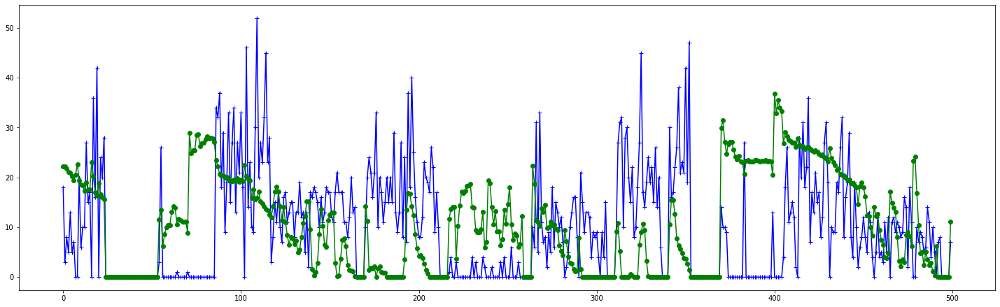

In [ ]:
fig, ax = plt.subplots(figsize=(25, 7.5))

k = np.random.randint(499)
z = 1000 + k

ax.plot(y_tst.flatten()[z:z+500], '-+b')
ax.plot(yp_test.flatten()[z:z+500], '-og')

plt.show()

---
## Model Selection & Conclusion
---
To solve the buiseness problem. Two models are created viz gradient boost regressor and lstm encode-decoder. As based on the evaluation metric defined earlier, LGB model after hyperparameter tuning gave best performance & thus refined model is chosen. After visually analyzing predictions from LSTM & GBM model it can be observed that LGB has better consistancy in prediction results, where as LSTM has unnecessary variations in results.
Performance of models can be summarized as below:

<table>
    <thead>
        <tr>
            <th>Algorithm</th>
            <th>Variation</th>
            <th>RSMLE</th>
            <th>Visual</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td rowspan=2>Gradient Boost</td>
            <td rowspan=1>Before tuning</td>
            <td>0.7174</td>
            <td>--<td>
        </tr>
        <tr>
            <td rowspan=1>After tuning</td>
            <td><b>0.7204</b></td>
            <td><b>OK </b></td>
        </tr>
    </tbody>
        <tbody>
        <tr>
            <td rowspan=3>Encoder-Decoder</td>
            <td rowspan=1>With 3 prev days</td>
            <td>1.6358</td>
            <td>---<td>
        </tr>
        <tr>
            <td rowspan=1>With 7 prev days</td>
            <td>2.0922</td>
            <td>---</td>
        </tr>
    </tbody>
</table>

In conclusion Fine-tuned gradient booster has better performance and is in acceptable level of metric. 


In [ ]:
filename1 = r'Model/GBM_basic_model.pkl'
pickle.dump(base_gbm, open(filename1, 'wb'))

filename2 = r'Model/GBM_tuned_model.pkl'
pickle.dump(fine_gbm, open(filename2, 'wb'))

filename3 = r'Model/LSTM_3_days_model.h5'
tr_model3.save(filename3)

filename4 = r'Model/LSTM_7_days_model.h5'
tr_model7.save(filename4)